In [1]:
!pip install missingno

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
from scipy import stats
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

# 1. EDA

## Первичный анализ данных

Для начала поймем, с чем мы вообще имеем дело:

In [6]:
df = pd.read_csv('kicksharing.csv')
df.head()

,order_rk,party_rk,gender_cd,age,education_level_cd,marital_status_cd,lvn_state_nm,minute_cost,activation_cost,hold_amount,transport_model,distance_km,created_dttm,book_start_dttm,book_end_dttm,book_time_zone_cd,local_book_start_dttm,nominal_price_rub_amt,loyalty_accrual_rub_amt,loyalty_accrual_bns_amt
0,266071307,761067705,M,40,UGR,DIV,ТЮМЕНСКАЯ ОБЛ,4.99,30.0,300.0,SL,3.690479,2024-08-07 09:47:25.000000,2024-08-07 09:47:29.325252,2024-08-07 10:07:59.339524,5,2024-08-07 11:47:29.325252,134.79,19.48,NaN
1,355113920,614049469,F,30,GRD,MAR,РОСТОВСКАЯ ОБЛ,8.49,50.0,300.0,SL,1.114912,2024-10-17 14:57:20.000000,2024-10-17 14:57:24.586000,2024-10-17 15:04:19.419607,3,2024-10-17 14:57:24.586000,109.43,40.30,NaN
2,347424551,757583701,M,28,UGR,UNM,СВЕРДЛОВСКАЯ ОБЛ,5.99,30.0,300.0,E,1.515612,2024-09-19 05:31:41.000000,2024-09-19 05:34:59.476000,2024-09-19 05:41:50.164372,5,2024-09-19 07:34:59.476000,71.93,10.79,NaN
3,351562959,541367366,M,24,GRD,UNM,Г МОСКВА,8.99,50.0,300.0,SL,0.499411,2024-10-04 16:05:09.000000,2024-10-04 16:05:13.162000,2024-10-04 16:07:31.724918,3,2024-10-04 16:05:13.162000,76.97,7.70,NaN
4,258647149,238473615,M,34,NaN,NaN,Г МОСКВА,6.99,50.0,300.0,SL,2.602028,2024-07-10 06:57:40.000000,2024-07-10 06:57:43.017125,2024-07-10 07:07:48.446462,3,2024-07-10 06:57:43.017125,126.89,25.38,NaN


In [7]:
print(f"Размерность датасета: {df.shape[0]}, {df.shape[1]}")

Размерность датасета: 396749, 20


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 396749 entries, 0 to 396748
Data columns (total 20 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   order_rk                 396749 non-null  int64  
 1   party_rk                 396749 non-null  int64  
 2   gender_cd                393828 non-null  object 
 3   age                      396749 non-null  int64  
 4   education_level_cd       190059 non-null  object 
 5   marital_status_cd        217729 non-null  object 
 6   lvn_state_nm             362572 non-null  object 
 7   minute_cost              396749 non-null  float64
 8   activation_cost          396749 non-null  float64
 9   hold_amount              396749 non-null  float64
 10  transport_model          396749 non-null  object 
 11  distance_km              396749 non-null  float64
 12  created_dttm             396749 non-null  object 
 13  book_start_dttm          396749 non-null  object 
 14  book

In [9]:
df.describe(include='all')

,order_rk,party_rk,gender_cd,age,education_level_cd,marital_status_cd,lvn_state_nm,minute_cost,activation_cost,hold_amount,transport_model,distance_km,created_dttm,book_start_dttm,book_end_dttm,book_time_zone_cd,local_book_start_dttm,nominal_price_rub_amt,loyalty_accrual_rub_amt,loyalty_accrual_bns_amt
count,3.967490e+05,3.967490e+05,393828,396749.000000,190059,217729,362572,396749.000000,396749.000000,396749.000000,396749,396749.000000,396749,396749,396749,396749.000000,396749,396749.000000,366992.000000,21948.000000
unique,NaN,NaN,2,NaN,5,5,212,NaN,NaN,NaN,14,NaN,387224,396745,396749,NaN,396746,NaN,NaN,NaN
top,NaN,NaN,M,NaN,GRD,UNM,Г МОСКВА,NaN,NaN,NaN,SL,NaN,2024-09-12 15:15:50.000000,2024-09-17 13:44:24.183000,2024-08-07 10:07:59.339524,NaN,2024-09-17 13:44:24.183000,NaN,NaN,NaN
freq,NaN,NaN,335458,NaN,94341,116094,90897,NaN,NaN,NaN,241247,NaN,4,2,1,NaN,2,NaN,NaN,NaN
mean,2.892236e+08,5.988426e+08,NaN,31.544006,NaN,NaN,NaN,7.288688,42.593226,299.983869,NaN,3.681031,NaN,NaN,NaN,3.536155,NaN,127.647694,37.516121,127.789319
std,3.813458e+07,3.311675e+08,NaN,9.434545,NaN,NaN,NaN,1.289492,11.989974,1.939153,NaN,141.862349,NaN,NaN,NaN,1.209075,NaN,100.122365,75.208560,496.812143
min,2.526112e+08,1.471700e+04,NaN,12.000000,NaN,NaN,NaN,1.500000,0.000000,80.000000,NaN,0.000000,NaN,NaN,NaN,0.000000,NaN,0.000000,-161.940000,1.000000
25%,2.618150e+08,2.962323e+08,NaN,24.000000,NaN,NaN,NaN,6.490000,30.000000,300.000000,NaN,0.941054,NaN,NaN,NaN,3.000000,NaN,80.840000,11.240000,43.000000
50%,2.704367e+08,6.110092e+08,NaN,31.000000,NaN,NaN,NaN,7.490000,50.000000,300.000000,NaN,1.729883,NaN,NaN,NaN,3.000000,NaN,103.940000,18.730000,62.000000
75%,3.432678e+08,8.646921e+08,NaN,37.000000,NaN,NaN,NaN,8.220000,50.000000,300.000000,NaN,3.063694,NaN,NaN,NaN,3.000000,NaN,142.100000,35.060000,81.000000


## Теперь займемся препроцессингом данных

#### **Сразу хочется сначала привести все даты к нужному типу (datetime64):**

In [12]:
datetime_cols = ['created_dttm', 'book_start_dttm', 'book_end_dttm', 'local_book_start_dttm']
print(datetime_cols)

for col in datetime_cols:
    df[col] = pd.to_datetime(df[col], errors='coerce')
    print(f"Привел {col} к типу {df[col].dtype}")

['created_dttm', 'book_start_dttm', 'book_end_dttm', 'local_book_start_dttm']
Привел created_dttm к типу datetime64[ns]
Привел book_start_dttm к типу datetime64[ns]
Привел book_end_dttm к типу datetime64[ns]
Привел local_book_start_dttm к типу datetime64[ns]


In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 396749 entries, 0 to 396748
Data columns (total 20 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   order_rk                 396749 non-null  int64         
 1   party_rk                 396749 non-null  int64         
 2   gender_cd                393828 non-null  object        
 3   age                      396749 non-null  int64         
 4   education_level_cd       190059 non-null  object        
 5   marital_status_cd        217729 non-null  object        
 6   lvn_state_nm             362572 non-null  object        
 7   minute_cost              396749 non-null  float64       
 8   activation_cost          396749 non-null  float64       
 9   hold_amount              396749 non-null  float64       
 10  transport_model          396749 non-null  object        
 11  distance_km              396749 non-null  float64       
 12  created_dttm    

Привели все даты к нужному типу.

#### **Отсутствующие значения**

Поработаем с NaN-ами

In [17]:
print(df.isna().sum())

order_rk                        0
party_rk                        0
gender_cd                    2921
age                             0
education_level_cd         206690
marital_status_cd          179020
lvn_state_nm                34177
minute_cost                     0
activation_cost                 0
hold_amount                     0
transport_model                 0
distance_km                     0
created_dttm                    0
book_start_dttm                 0
book_end_dttm                   0
book_time_zone_cd               0
local_book_start_dttm           0
nominal_price_rub_amt           0
loyalty_accrual_rub_amt     29757
loyalty_accrual_bns_amt    374801
dtype: int64


In [18]:
missing = df.isnull().sum().sort_values(ascending=False)
print("Отсутствующие значения в каждом столбце:\n", missing[missing > 0])

Отсутствующие значения в каждом столбце:
 loyalty_accrual_bns_amt    374801
education_level_cd         206690
marital_status_cd          179020
lvn_state_nm                34177
loyalty_accrual_rub_amt     29757
gender_cd                    2921
dtype: int64


In [19]:
total = df.shape[0]
print((missing/total * 100).round(2))

loyalty_accrual_bns_amt    94.47
education_level_cd         52.10
marital_status_cd          45.12
lvn_state_nm                8.61
loyalty_accrual_rub_amt     7.50
gender_cd                   0.74
created_dttm                0.00
nominal_price_rub_amt       0.00
local_book_start_dttm       0.00
book_time_zone_cd           0.00
book_end_dttm               0.00
book_start_dttm             0.00
order_rk                    0.00
distance_km                 0.00
party_rk                    0.00
hold_amount                 0.00
activation_cost             0.00
minute_cost                 0.00
age                         0.00
transport_model             0.00
dtype: float64


Нарисуем тепловую карту пропущенных данных для визуализации:

<Axes: >

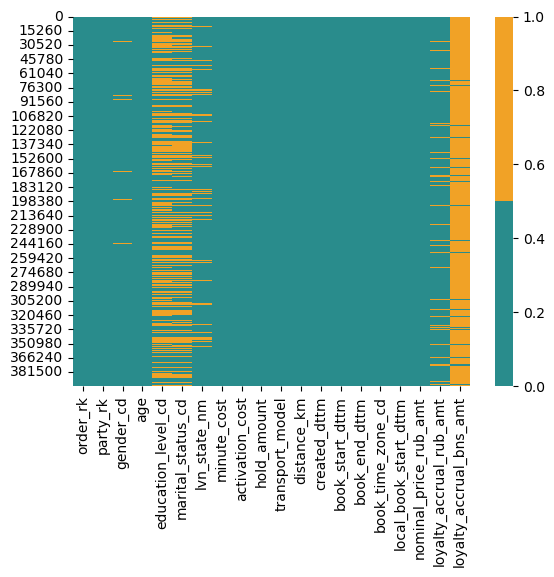

In [21]:
cols = df.columns[:20]
# желтый - отсутствующие данные, зеленый - не отсутствующие
colours = ['#298c8c', '#f1a226'] 
sns.heatmap(df[cols].isnull(), cmap=sns.color_palette(colours))

Признак loyalty_accrual_bns_amt слишком малоинформативный, как-то работать с ним, заполняя отсутствующие значения модой и тд., я не вижу смысла, поэтому просто выкидываем эту категорию, она итак почти полностью пустая и никакой информации почти не дает

In [23]:
df.shape

(396749, 20)

In [24]:
df.drop('loyalty_accrual_bns_amt', axis=1, inplace=True)

In [25]:
df.shape

(396749, 19)

In [26]:
missing = df.isnull().sum().sort_values(ascending=False)
total = df.shape[0]
print((missing/total * 100).round(2))

education_level_cd         52.10
marital_status_cd          45.12
lvn_state_nm                8.61
loyalty_accrual_rub_amt     7.50
gender_cd                   0.74
created_dttm                0.00
nominal_price_rub_amt       0.00
local_book_start_dttm       0.00
book_time_zone_cd           0.00
book_end_dttm               0.00
book_start_dttm             0.00
order_rk                    0.00
distance_km                 0.00
transport_model             0.00
party_rk                    0.00
activation_cost             0.00
minute_cost                 0.00
age                         0.00
hold_amount                 0.00
dtype: float64


In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 396749 entries, 0 to 396748
Data columns (total 19 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   order_rk                 396749 non-null  int64         
 1   party_rk                 396749 non-null  int64         
 2   gender_cd                393828 non-null  object        
 3   age                      396749 non-null  int64         
 4   education_level_cd       190059 non-null  object        
 5   marital_status_cd        217729 non-null  object        
 6   lvn_state_nm             362572 non-null  object        
 7   minute_cost              396749 non-null  float64       
 8   activation_cost          396749 non-null  float64       
 9   hold_amount              396749 non-null  float64       
 10  transport_model          396749 non-null  object        
 11  distance_km              396749 non-null  float64       
 12  created_dttm    

Также можем видеть что в нашем датасете еще есть два признака, где почти половина значений неопределены и это: уровень образования и семейный статус. При заполнении пустых значений для таких признаков, где отсутствует ощутимая часть данных, мы не можем просто заполнить их модой (или медианой для числовых), потому что в таком случае данные сильно исказятся и соотношение значений очень сильно сместится в пользу одного из признаков, исказив и испортив наши данные.

Чтобы понять, как обрабатывать отсутствующие значения, давайте взглянем, есть ли какие-то корреляции между признаками с большим процентом отсутствующих данных и остальными признаками (например, что люди старшнего возраста чаще скрывают уровень образования).

In [30]:
key_cols_all = ['education_level_cd', 'marital_status_cd']
key_cols = [col for col in key_cols_all if col in df.columns]
missing_cols = set(key_cols_all) - set(key_cols)

df_missing = df.copy()
for col in key_cols:
    df_missing[f'{col}_is_nan'] = df_missing[col].isnull().astype(int)

num_feats = [c for c in df_missing.select_dtypes(include=[np.number]).columns if not c.endswith('_is_nan')]
if key_cols and num_feats:
    missing_corr = {}
    for col in key_cols:
        flag = f'{col}_is_nan'
        corr_vals = df_missing[num_feats].corrwith(df_missing[flag]).abs().sort_values(ascending=False)
        missing_corr[col] = corr_vals
        print(f"Корреляции между отсутствующими значениями '{flag}' и числовыми признаками:")
        print(corr_vals.head(5))

Корреляции между отсутствующими значениями 'education_level_cd_is_nan' и числовыми признаками:
party_rk           0.411670
age                0.166481
order_rk           0.040453
minute_cost        0.034498
activation_cost    0.019503
dtype: float64
Корреляции между отсутствующими значениями 'marital_status_cd_is_nan' и числовыми признаками:
party_rk             0.333720
age                  0.194046
minute_cost          0.048379
order_rk             0.041834
book_time_zone_cd    0.036545
dtype: float64


Как мы видим, с числовыми признаками корреляций никаких не наблюдается (party_rk это идентификатор клиента, и коэф. корреляции 0.41 и 0.33 явно случайны, потому что идентификатор явно не имеет никакой связи вообще с любым другим признаком, так как генерируется независимо от других от каких-то других факторов).

Проанализируем категориальные признаки:

In [33]:
categorical_feats = [c for c in df.columns if df[c].dtype == 'object' or df[c].dtype.name == 'category']
categorical_feats = [c for c in categorical_feats if c not in key_cols_all]

categorical_feats = ['gender_cd', 'lvn_state_nm', 'transport_model']

print(categorical_feats)
print()

for col in key_cols:
    flag = f'{col}_is_nan'
    print(f"Распределение NaN-ов '{col}' по категориальными признакам:\n")
    for cat in categorical_feats:
        ct = pd.crosstab(df_missing[cat], df_missing[flag], normalize='index')
        print(f"By {cat}:")
        print(ct)
        print('-'*50)

['gender_cd', 'lvn_state_nm', 'transport_model']

Распределение NaN-ов 'education_level_cd' по категориальными признакам:

By gender_cd:
education_level_cd_is_nan         0         1
gender_cd                                    
F                          0.438941  0.561059
M                          0.489850  0.510150
--------------------------------------------------
By lvn_state_nm:
education_level_cd_is_nan                           0         1
lvn_state_nm                                                   
ISRAEL                                       0.000000  1.000000
АЛТАЙСКИЙ КРАЙ                               0.585313  0.414687
АМУРСКАЯ ОБЛ                                 0.746439  0.253561
АО ХАНТЫ-МАНСИЙСКИЙ АВТОНОМНЫЙ ОКРУГ - ЮГРА  0.187500  0.812500
АО ЯМАЛО-НЕНЕЦКИЙ                            0.000000  1.000000
...                                               ...       ...
ЧУВАШСКАЯ РЕСПУБЛИКА - ЧУВАШИЯ               0.430246  0.569754
ЧУВАШСКАЯ РЕСПУБЛИКА ЧУВАШИЯ       

Как мы видим, для категориальных признаков никаких явных корреляций также обнаружено не было, то есть связать пропуски с какими-то другими факторами (например, что в основном женщины скрывают свой семейный статус, или что люди катающиеся на Urban E-Bike чаще скрывают уровень образования) мы не можем.

Значит, моделировать пропуски с помощью каких-то моделей классификаций и прочего, здесь не имеет смысла, так как значимых корреляций не было обнаружено. Поэтому просто добавим категорию "unknown" для наших отсутствующих значений, в данной ситуации так будет правильнее сделать, чем выдумывать новую информацию.

In [35]:
print(key_cols)

for col in key_cols:
    if col in df.columns:
        df[col].fillna('unknown', inplace=True)
        print(f"Заменил все NaN в {col} на 'unknown'")

['education_level_cd', 'marital_status_cd']
Заменил все NaN в education_level_cd на 'unknown'
Заменил все NaN в marital_status_cd на 'unknown'


In [36]:
missing = df.isnull().sum().sort_values(ascending=False)
total = df.shape[0]
print((missing/total * 100).round(2))

lvn_state_nm               8.61
loyalty_accrual_rub_amt    7.50
gender_cd                  0.74
distance_km                0.00
nominal_price_rub_amt      0.00
local_book_start_dttm      0.00
book_time_zone_cd          0.00
book_end_dttm              0.00
book_start_dttm            0.00
created_dttm               0.00
order_rk                   0.00
transport_model            0.00
party_rk                   0.00
activation_cost            0.00
minute_cost                0.00
marital_status_cd          0.00
education_level_cd         0.00
age                        0.00
hold_amount                0.00
dtype: float64


Для признаков, где всего <9% значений отсутствует, может просто заполнить все отсутствующие значения медианой и модой.

Заполним отсутствующие значения в столбцах lvn_state_nm и gender_cd модой:

In [39]:
for col in ['lvn_state_nm','gender_cd']:
    mode_val = df[col].mode()[0]
    df[col].fillna(mode_val, inplace=True)
    print(f"Заменил все NaN в {col} на моду='{mode_val}'")

Заменил все NaN в lvn_state_nm на моду='Г МОСКВА'
Заменил все NaN в gender_cd на моду='M'


Заполним отсутствующие значения в столбце loyalty_accrual_rub_amt медианой:

In [41]:
col = 'loyalty_accrual_rub_amt'

med_val = df[col].median()
df[col].fillna(med_val, inplace=True)
print(f"Заменил все NaN в {col} на медиану={med_val}")

Заменил все NaN в loyalty_accrual_rub_amt на медиану=18.73


In [42]:
missing = df.isnull().sum().sort_values(ascending=False)
total = df.shape[0]
print((missing/total * 100).round(2))

order_rk                   0.0
transport_model            0.0
nominal_price_rub_amt      0.0
local_book_start_dttm      0.0
book_time_zone_cd          0.0
book_end_dttm              0.0
book_start_dttm            0.0
created_dttm               0.0
distance_km                0.0
hold_amount                0.0
party_rk                   0.0
activation_cost            0.0
minute_cost                0.0
lvn_state_nm               0.0
marital_status_cd          0.0
education_level_cd         0.0
age                        0.0
gender_cd                  0.0
loyalty_accrual_rub_amt    0.0
dtype: float64


Мы обработали все отсутствующие значения!

#### **Найдем аномалии и выбросы**

Проанализируем выбросы и аномалии возраста

IQR АНАЛИЗ ВЫБРОСОВ ДЛЯ AGE
Базовая статистика для возраста:


count    396749.000000
mean         31.544006
std           9.434545
min          12.000000
25%          24.000000
50%          31.000000
75%          37.000000
max          94.000000
Name: age, dtype: float64

Границы выбросов: lower=4.50, upper=56.50
Найдено выбросов: 5678 (1.43%)


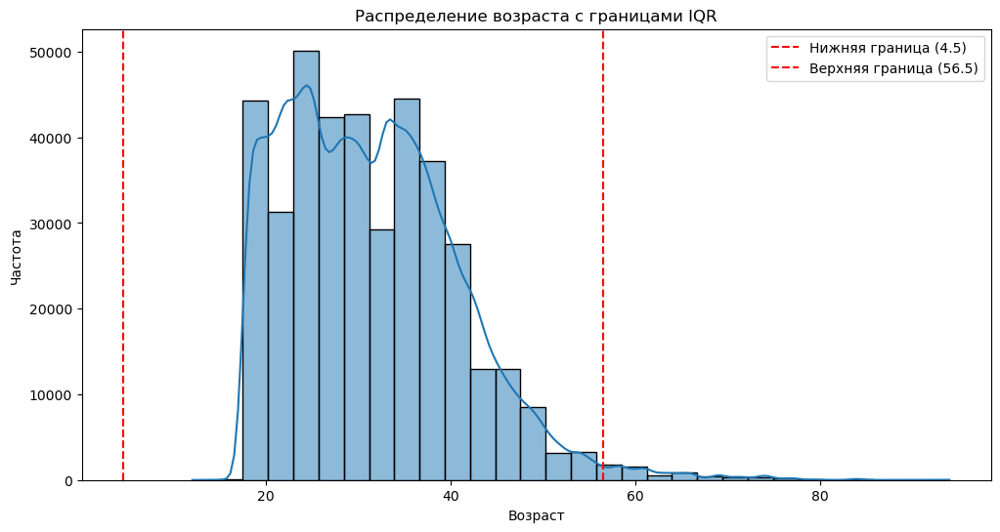

Примеры выбросов:


,order_rk,party_rk,gender_cd,age,education_level_cd,marital_status_cd,lvn_state_nm,minute_cost,activation_cost,hold_amount,transport_model,distance_km,created_dttm,book_start_dttm,book_end_dttm,book_time_zone_cd,local_book_start_dttm,nominal_price_rub_amt,loyalty_accrual_rub_amt
59,258384188,427905536,M,24,SCH,UNM,АСТРАХАНСКАЯ ОБЛ,8.49,30.0,300.0,ES400,6.506504,2024-07-09 12:25:57,2024-07-09 12:26:02.011007,2024-07-09 12:51:30.960547,3,2024-07-09 12:26:02.011007,250.74,37.61
67,259468085,515916901,M,33,UGR,DIV,Г МОСКВА,6.99,50.0,300.0,SL,0.760188,2024-07-13 11:50:14,2024-07-13 11:50:16.893682,2024-07-13 11:54:49.782531,3,2024-07-13 11:50:16.893682,84.95,16.99
69,267910955,890407115,M,20,GRD,UNM,НОВОСИБИРСКАЯ ОБЛ,5.99,30.0,300.0,E,0.015305,2024-08-14 14:20:47,2024-08-14 14:20:52.015257,2024-08-14 14:22:03.113541,7,2024-08-14 18:20:52.015257,41.98,10.40
84,265812681,760405473,M,21,UGR,UNM,САХАЛИНСКАЯ ОБЛ,9.49,50.0,300.0,Max,1.651345,2024-08-06 03:41:25,2024-08-06 03:41:27.914392,2024-08-06 03:50:37.901942,11,2024-08-06 11:41:27.914392,144.90,28.98
75,274720095,145980946,F,26,unknown,unknown,ЛИПЕЦКАЯ ОБЛ,8.99,50.0,300.0,SL,1.098580,2024-09-07 11:31:40,2024-09-07 11:31:46.579000,2024-09-07 11:35:43.832267,3,2024-09-07 11:31:46.579000,85.96,12.40
58,275216315,383143019,M,22,unknown,unknown,МОСКОВСКАЯ ОБЛ,6.99,50.0,300.0,Urban E-Bike,1.295078,2024-09-09 16:46:45,2024-09-09 16:46:49.546000,2024-09-09 16:51:00.262257,3,2024-09-09 16:46:49.546000,84.95,21.00
66,347724088,391309281,M,37,SCH,UNM,Г САНКТ-ПЕТЕРБУРГ,7.99,50.0,300.0,SL,1.642321,2024-09-20 14:05:25,2024-09-20 14:05:31.098000,2024-09-20 14:09:51.082530,3,2024-09-20 14:05:31.098000,89.95,9.00
61,266323193,63607581,M,39,GRD,MAR,МОСКОВСКАЯ ОБЛ,5.99,50.0,300.0,Urban E-Bike,1.099397,2024-08-08 15:53:50,2024-08-08 15:53:53.757771,2024-08-08 15:57:24.740705,3,2024-08-08 15:53:53.757771,73.96,18.00
77,352576179,937182287,F,28,unknown,unknown,ПСКОВСКАЯ ОБЛ,6.99,50.0,300.0,SL,2.983675,2024-10-08 06:09:14,2024-10-08 06:09:17.674000,2024-10-08 06:21:19.436697,3,2024-10-08 06:09:17.674000,126.89,56.38
66,347724088,391309281,M,37,SCH,UNM,Г САНКТ-ПЕТЕРБУРГ,7.99,50.0,300.0,SL,1.642321,2024-09-20 14:05:25,2024-09-20 14:05:31.098000,2024-09-20 14:09:51.082530,3,2024-09-20 14:05:31.098000,89.95,9.00


In [46]:
column = 'age'
print(f"{'='*50}")
print(f"IQR АНАЛИЗ ВЫБРОСОВ ДЛЯ {column.upper()}")
print(f"{'='*50}")

print("Базовая статистика для возраста:")
stats_info = df[column].describe()
display(stats_info)

Q1, Q3 = df[column].quantile(0.25), df[column].quantile(0.75)
IQR = Q3 - Q1
lower_bound, upper_bound = Q1 - 1.5 * IQR, Q3 + 1.5 * IQR
print(f"Границы выбросов: lower={lower_bound:.2f}, upper={upper_bound:.2f}")

outlier_mask = (df[column] < lower_bound) | (df[column] > upper_bound)
outliers = df.loc[outlier_mask, column]
print(f"Найдено выбросов: {outliers.shape[0]} ({outliers.shape[0]/df.shape[0]*100:.2f}%)")

plt.figure(figsize=(12,6))
sns.histplot(df[column], kde=True, bins=30)
plt.axvline(lower_bound, color='red', linestyle='--', label=f'Нижняя граница ({lower_bound:.1f})')
plt.axvline(upper_bound, color='red', linestyle='--', label=f'Верхняя граница ({upper_bound:.1f})')
plt.title('Распределение возраста с границами IQR')
plt.xlabel('Возраст')
plt.ylabel('Частота')
plt.legend()
plt.show()

fig = px.box(df, y=column, title='Интерактивный ящик с усами для возраста')
fig.update_layout(yaxis_title='Возраст')
fig.show()

print("Примеры выбросов:")
display(df.loc[outliers[:min(10, len(outliers))], :])


Анализ выбросов distance_km:

In [48]:
column = 'distance_km'
print(f"{'='*50}")
print(f"IQR АНАЛИЗ ВЫБРОСОВ ДЛЯ {column.upper()}")
print(f"{'='*50}")

print(f"Базовая статистика для {column}:")
stats_info = df[column].describe()
display(stats_info)

Q1, Q3 = df[column].quantile(0.25), df[column].quantile(0.75)
IQR = Q3 - Q1
lower_bound, upper_bound = Q1 - 1.5 * IQR, Q3 + 1.5 * IQR
print(f"Границы выбросов: lower={lower_bound:.2f}, upper={upper_bound:.2f}")

outlier_mask = (df[column] < lower_bound) | (df[column] > upper_bound)
outliers = df.loc[outlier_mask, column]
print(f"Найдено выбросов: {outliers.shape[0]} ({outliers.shape[0]/df.shape[0]*100:.2f}%)")

print("Примеры выбросов в distance_km:")
display(df.loc[outlier_mask].head(10))

IQR АНАЛИЗ ВЫБРОСОВ ДЛЯ DISTANCE_KM
Базовая статистика для distance_km:


count    396749.000000
mean          3.681031
std         141.862349
min           0.000000
25%           0.941054
50%           1.729883
75%           3.063694
max       56012.640308
Name: distance_km, dtype: float64

Границы выбросов: lower=-2.24, upper=6.25
Найдено выбросов: 26495 (6.68%)
Примеры выбросов в distance_km:


,order_rk,party_rk,gender_cd,age,education_level_cd,marital_status_cd,lvn_state_nm,minute_cost,activation_cost,hold_amount,transport_model,distance_km,created_dttm,book_start_dttm,book_end_dttm,book_time_zone_cd,local_book_start_dttm,nominal_price_rub_amt,loyalty_accrual_rub_amt
17,263336349,799303695,M,19,unknown,unknown,КРАСНОДАРСКИЙ КРАЙ,4.99,35.0,300.0,SL,7.158124,2024-07-28 20:14:10,2024-07-28 20:14:15.859461,2024-07-28 20:30:58.251210,3,2024-07-28 20:14:15.859461,119.83,66.11
24,277396858,622639837,F,24,unknown,unknown,СМОЛЕНСКАЯ ОБЛ,7.49,50.0,300.0,SL,10.857191,2024-09-10 20:06:29,2024-09-10 20:06:32.116000,2024-09-10 20:57:15.094291,3,2024-09-10 20:06:32.116000,431.99,431.99
28,291383137,678375751,M,39,GRD,MAR,КРАСНОЯРСКИЙ КРАЙ,5.99,0.0,300.0,SL,14.387959,2024-09-11 03:48:17,2024-09-11 03:48:21.289000,2024-09-11 04:37:24.592000,7,2024-09-11 07:48:21.289000,299.50,29.95
39,272726836,952764064,M,46,SCH,DIV,МОСКОВСКАЯ ОБЛ,9.49,50.0,300.0,SL,10.594007,2024-08-31 14:14:15,2024-08-31 14:14:20.123357,2024-08-31 14:52:48.543297,3,2024-08-31 14:14:20.123357,420.11,84.02
59,258384188,427905536,M,24,SCH,UNM,АСТРАХАНСКАЯ ОБЛ,8.49,30.0,300.0,ES400,6.506504,2024-07-09 12:25:57,2024-07-09 12:26:02.011007,2024-07-09 12:51:30.960547,3,2024-07-09 12:26:02.011007,250.74,37.61
88,262576877,684382319,M,32,unknown,UNM,КРАСНОДАРСКИЙ КРАЙ,4.99,35.0,300.0,SL,17.866405,2024-07-25 05:00:04,2024-07-25 05:00:07.915984,2024-07-25 05:57:18.197249,3,2024-07-25 05:00:07.915984,324.42,32.45
93,272070066,867468047,M,21,SCH,UNM,РЕСП ТАТАРСТАН,6.99,30.0,300.0,SL,7.464013,2024-08-29 10:47:07,2024-08-29 10:47:11.062482,2024-08-29 11:12:47.262359,3,2024-08-29 10:47:11.062482,211.74,211.74
94,272402257,620037932,M,39,unknown,unknown,РЕСП УДМУРТСКАЯ,6.99,50.0,300.0,Max,20.512304,2024-08-30 14:46:35,2024-08-30 14:46:40.157798,2024-08-30 15:46:46.980933,4,2024-08-30 15:46:40.157798,476.39,47.64
96,306065754,425965106,M,26,GRD,UNM,САМАРСКАЯ ОБЛ,8.25,50.0,300.0,SL,6.990180,2024-09-12 18:48:35,2024-09-12 18:48:37.434000,2024-09-12 19:21:48.442348,3,2024-09-12 18:48:37.434000,330.50,330.50
102,252622045,857791744,F,22,unknown,unknown,РЕСП КРЫМ,8.99,50.0,300.0,SL,6.586748,2024-06-02 11:26:22,2024-06-02 11:26:25.466198,2024-06-02 11:30:27.628911,3,2024-06-02 11:26:25.466198,94.95,18.00


Проанализируем выбросы для minute_cost:

IQR АНАЛИЗ ВЫБРОСОВ ДЛЯ MINUTE_COST
Базовая статистика для minute_cost:


count    396749.000000
mean          7.288688
std           1.289492
min           1.500000
25%           6.490000
50%           7.490000
75%           8.220000
max          19.990000
Name: minute_cost, dtype: float64

Границы выбросов: lower=3.89, upper=10.82
Найдено выбросов: 65 (0.02%)


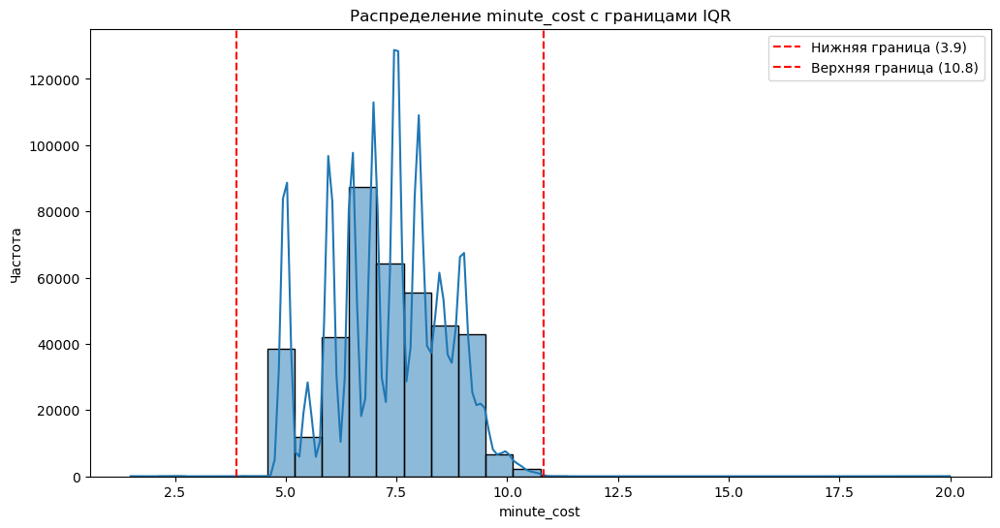

Примеры выбросов в minute_cost:


,order_rk,party_rk,gender_cd,age,education_level_cd,marital_status_cd,lvn_state_nm,minute_cost,activation_cost,hold_amount,transport_model,distance_km,created_dttm,book_start_dttm,book_end_dttm,book_time_zone_cd,local_book_start_dttm,nominal_price_rub_amt,loyalty_accrual_rub_amt
16038,266602218,791320911,M,34,GRD,MAR,КРАСНОДАРСКИЙ КРАЙ,1.50,5.0,80.0,Lucky,0.000000,2024-08-09 19:41:55,2024-08-09 19:41:58.426053,2024-08-09 20:30:41.418000,3,2024-08-09 19:41:58.426053,78.50,23.55
16950,265317197,146827875,M,36,GRD,UNM,Г МОСКВА,19.99,50.0,300.0,SL,2.313658,2024-08-04 06:44:03,2024-08-04 06:44:05.742134,2024-08-04 06:54:07.789127,7,2024-08-04 10:44:05.742134,269.89,53.98
17400,274147824,819492789,M,18,unknown,unknown,РЕСП БАШКОРТОСТАН,2.00,0.0,300.0,Lucky,0.000000,2024-09-05 14:14:46,2024-09-05 14:14:48.978652,2024-09-05 14:15:18.516407,5,2024-09-05 16:14:48.978652,0.00,18.73
18350,350277704,771579225,M,35,unknown,unknown,Г МОСКВА,2.50,0.0,300.0,Lucky,0.000000,2024-09-29 16:44:08,2024-09-29 16:44:12.121000,2024-09-29 16:45:05.966562,3,2024-09-29 16:44:12.121000,0.00,18.73
18608,267910412,1169868540,M,23,SCH,UNM,КРАСНОДАРСКИЙ КРАЙ,1.50,5.0,80.0,Lucky,0.234842,2024-08-14 19:54:56,2024-08-14 19:55:00.692540,2024-08-15 00:35:01.877000,3,2024-08-14 19:55:00.692540,425.00,63.50
22526,347723225,1009974722,F,70,unknown,unknown,Г МОСКВА,2.00,0.0,300.0,Lucky,0.000000,2024-09-20 15:22:46,2024-09-20 15:22:55.429000,2024-09-20 15:33:40.560373,5,2024-09-20 17:22:55.429000,22.00,22.00
23126,269077903,1049099609,M,21,unknown,UNM,РЕСП АЛТАЙ,19.99,50.0,300.0,SL,0.520810,2024-08-18 11:53:29,2024-08-18 11:53:34.195149,2024-08-18 11:55:28.074805,7,2024-08-18 15:53:34.195149,89.98,26.50
28890,263994391,346856261,M,36,unknown,unknown,СВЕРДЛОВСКАЯ ОБЛ,19.99,50.0,300.0,SL,1.061450,2024-07-30 10:22:11,2024-07-30 10:22:16.945429,2024-07-30 10:26:50.188996,7,2024-07-30 14:22:16.945429,149.95,61.48
37055,350558639,311148743,M,30,GRD,UNM,РЕСП БАШКОРТОСТАН,2.00,0.0,300.0,Lucky,0.000000,2024-09-30 06:04:48,2024-09-30 06:05:02.637000,2024-09-30 06:06:35.494123,5,2024-09-30 08:05:02.637000,4.00,18.73
37309,266325652,153512777,M,32,GRD,UNM,САРАТОВСКАЯ ОБЛ,19.99,50.0,300.0,SL,1.231359,2024-08-08 13:58:14,2024-08-08 13:58:21.606102,2024-08-08 14:01:07.472646,7,2024-08-08 17:58:21.606102,109.97,21.99


In [50]:
column = 'minute_cost'
print(f"{'='*50}")
print(f"IQR АНАЛИЗ ВЫБРОСОВ ДЛЯ {column.upper()}")
print(f"{'='*50}")

print(f"Базовая статистика для {column}:")
stats_info = df[column].describe()
display(stats_info)

Q1, Q3 = df[column].quantile(0.25), df[column].quantile(0.75)
IQR = Q3 - Q1
lower_bound, upper_bound = Q1 - 1.5 * IQR, Q3 + 1.5 * IQR
print(f"Границы выбросов: lower={lower_bound:.2f}, upper={upper_bound:.2f}")

outlier_mask = (df[column] < lower_bound) | (df[column] > upper_bound)
outliers = df.loc[outlier_mask, column]
print(f"Найдено выбросов: {outliers.shape[0]} ({outliers.shape[0]/df.shape[0]*100:.2f}%)")

plt.figure(figsize=(12,6))
sns.histplot(df[column], kde=True, bins=30)
plt.axvline(lower_bound, color='red', linestyle='--', label=f'Нижняя граница ({lower_bound:.1f})')
plt.axvline(upper_bound, color='red', linestyle='--', label=f'Верхняя граница ({upper_bound:.1f})')
plt.title(f'Распределение {column} с границами IQR')
plt.xlabel(column)
plt.ylabel('Частота')
plt.legend()
plt.show()

fig = px.box(df, y=column, title=f'Интерактивный ящик с усами для {column}')
fig.update_layout(yaxis_title=column)
fig.show()

print("Примеры выбросов в minute_cost:")
display(df.loc[outlier_mask].head(10))

#### **Построим матрицу корреляций**

In [52]:
num_cols = df.select_dtypes(include=['float','int']).columns

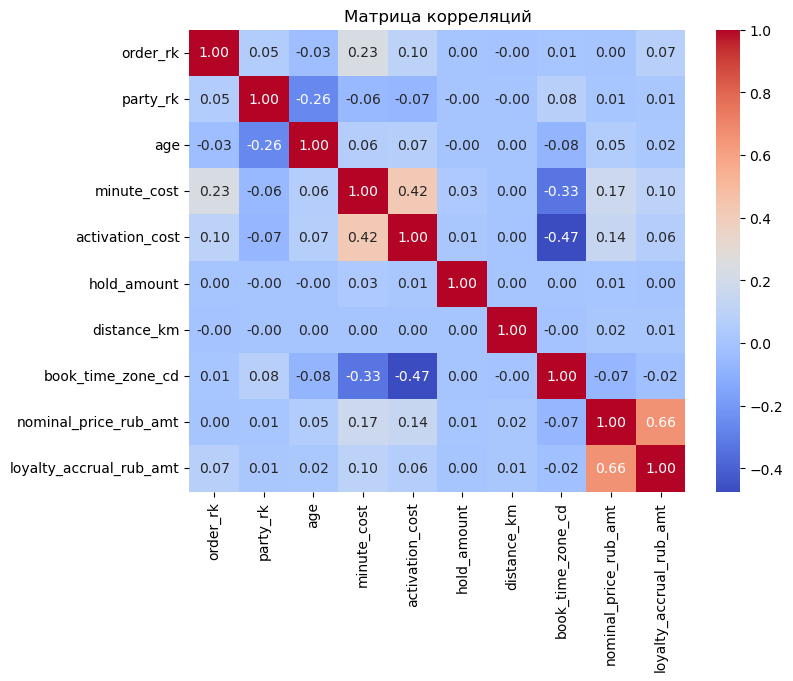

In [53]:
plt.figure(figsize=(8,6))
corr = df[num_cols].corr()
sns.heatmap(corr, annot=True, fmt='.2f', cmap='coolwarm')
plt.title("Матрица корреляций")
plt.show()

# 2. Продуктовые гипотезы

#### **Гипотеза 1.** Персонализация кэшбэка для длинных поездок

**ЕСЛИ** мы начнем начислять повышенный кэшбэк за поездки длиннее 15 км, **ТО** доля таких поездок вырастет **ПОТОМУ ЧТО** люди будут чаще арендовать самокат для долгих поездок из-за бонусного кэшбека

#### **Гипотеза 2.** Оптимизация стоимости минуты в часы пик

**ЕСЛИ** повысим minute_cost в часы пик (часы пик можем определить по данным), **ТО** доход от поездок в эти периоды увеличится **ПОТОМУ ЧТО** пользователи готовы платить больше за доступность в высокий спрос 

#### **Гипотеза 3.**  Персонализация кэшбэка для пользователей с высокой активностью
**ЕСЛИ** предложим пользователям с 10+ поездками в месяц (можем из данных найти таких юзеров по айдишнику) повышенный кэшбэк, **ТО** их retention rate повысится **ПОТОМУ ЧТО** активные клиенты еще сильнее вовлекаются, когда им делают выгодные специальные предложения